In [25]:
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np

In [8]:
#load audio files
fear_file = "audio\The Only Thing They Fear Is You.mp3"
meathook_file = "audio\Meathook.mp3"

In [9]:
ipd.Audio(fear_file)

In [10]:
ipd.Audio(meathook_file)

In [11]:
fear, sr = librosa.load(fear_file)
meathook, _ = librosa.load(meathook_file)

In [12]:
fear

array([-1.01174905e-07, -7.04118932e-08, -1.88467064e-09, ...,
       -4.25116919e-09, -3.67920904e-07,  0.00000000e+00], dtype=float32)

In [13]:
fear.size

9117443

In [14]:
meathook.size

8084098

In [15]:
#duration of 1 sample
sample_duration = 1/sr
print(f"Duration of 1 sample is: {sample_duration:.6f} seconds")

Duration of 1 sample is: 0.000045 seconds


In [17]:
#duration of audio signal in seconds
duration = sample_duration * len(fear)
print(f"Duration of the audio signal is: {duration:.2f} seconds")

Duration of the audio signal is: 413.49 seconds


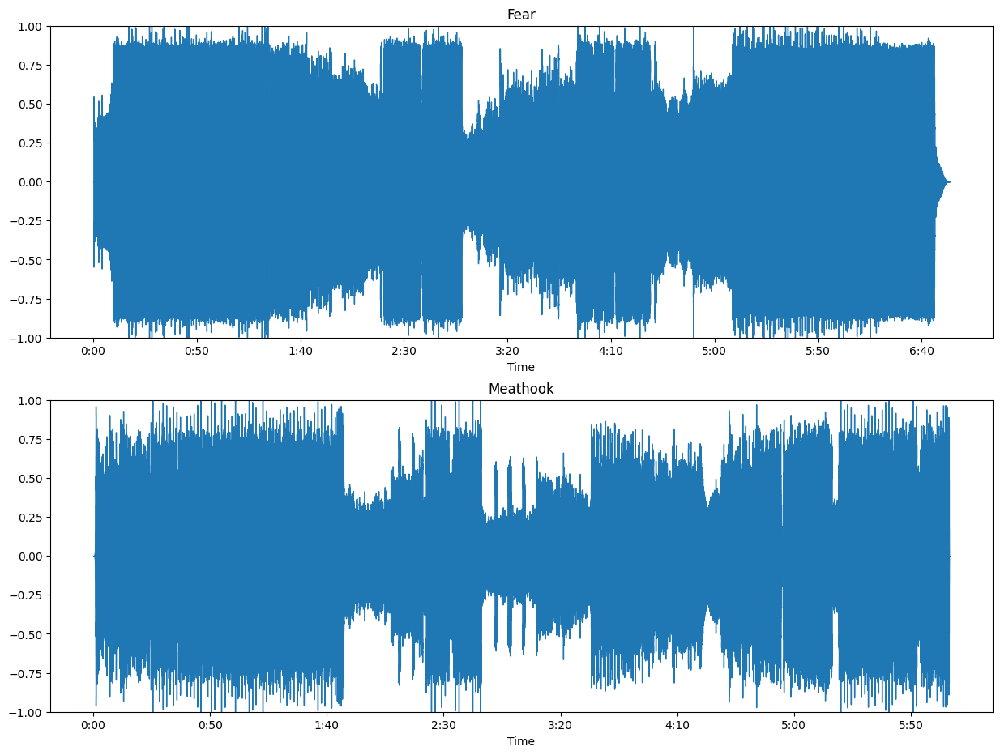

In [23]:
#visualise the waveform
plt.figure(figsize=(15,17))

plt.subplot(3,1,1)
librosa.display.waveshow(fear)
plt.title("Fear")
plt.ylim((-1,1))

plt.subplot(3,1,2)
librosa.display.waveshow(meathook)
plt.title("Meathook")
plt.ylim((-1,1))

plt.show()

In [33]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

#calculate the amplitude envelope
def amplitude_envelope(signal, frame_size, hop_length):
    amplitude_envelope = []

    #calculate AE for each frame
    for i in range(0,len(signal), hop_length):
        current_frame_amplitude_envelope = max(signal[i:i+frame_size])
        amplitude_envelope.append(current_frame_amplitude_envelope)

    return np.array(amplitude_envelope)

def fancy_amplitude_envelope(signal, frame_size, hop_length):
    return np.array([max(signal[i:i+frame_size]) for i in range(0, signal.size,hop_length)])


In [45]:
ae_fear = amplitude_envelope(fear, FRAME_SIZE, HOP_LENGTH)
ae_meathook = amplitude_envelope(meathook, FRAME_SIZE, HOP_LENGTH)
len(ae_fear)
len(ae_meathook)

15790

In [37]:
fancy_ae_fear = fancy_amplitude_envelope(fear, FRAME_SIZE, HOP_LENGTH)
fancy_ae_meathook = fancy_amplitude_envelope(meathook, FRAME_SIZE, HOP_LENGTH)

In [41]:
(ae_fear == fancy_ae_fear).all()
(ae_meathook == fancy_ae_meathook).all()

np.True_

ValueError: x and y must have same first dimension, but have shapes (17808,) and (15790,)

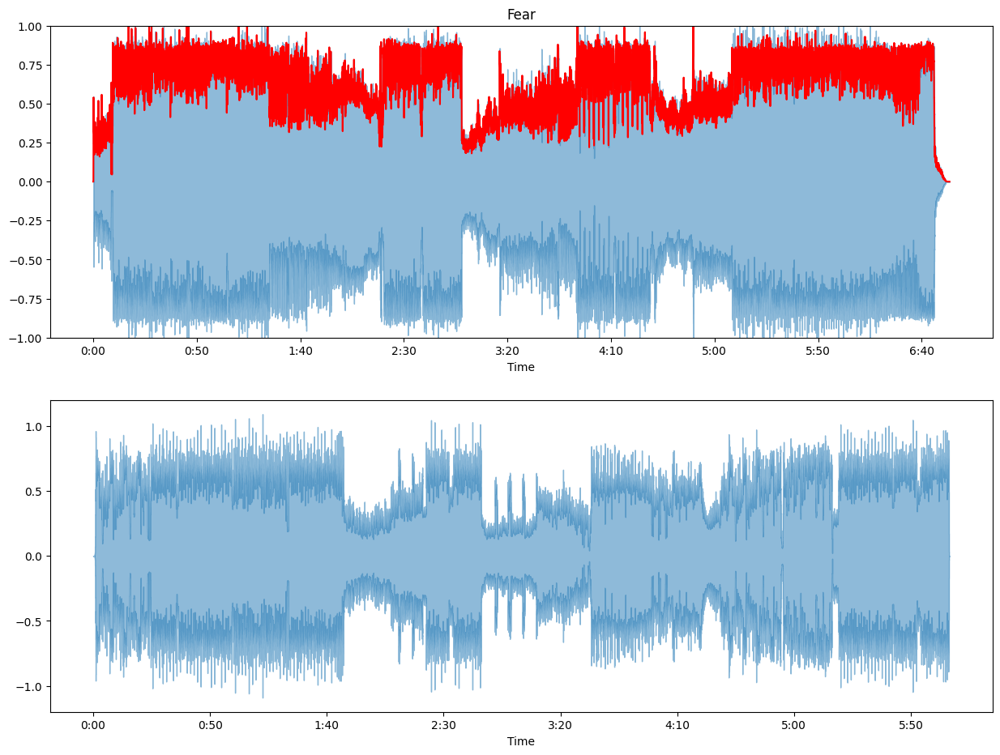

In [42]:
#visualize amplitude envelope for all the audio files

frames = range(0,ae_fear.size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)

plt.figure(figsize=(15,17))

plt.subplot(3,1,1)
librosa.display.waveshow(fear, alpha=0.5)
plt.plot(t, ae_fear, color = 'r')
plt.title("Fear")
plt.ylim((-1,1))

plt.subplot(3,1,2)
librosa.display.waveshow(meathook, alpha = 0.5)
plt.plot(t, ae_meathook, color = 'r')
plt.title("Meathook")
plt.ylim((-1,1))

plt.show()